<a href="https://colab.research.google.com/github/dolekhanhdang/Final_Project-CUDA-2022/blob/main/Report_SeamCarving_English.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Parallel Programming
# Final Project Report

## Group 15

Member

| MSSV | Họ và tên |
| --- | --- |
| 19120186 | Đỗ Lê Khánh Đăng |
| 19120364 | Nguyễn Đắc Thắng |

## 1. Application Descriptione:

The application that the team has chosen is the “seam carving” image resizing algorithm.
<br/>
> Input: An RGB image  <br/>

> Output: An image that has been reduced in width without distorting important objects.<br/>

The practical significance of the application::<br/>
- Adjust the image size to display at the desired resolution without losing important objects.
- This application needs to be accelerated because it runs very slowly when executed sequentially.


## 2. Sequential Algorithm

### Design

- **Step 1**: Read the PNM type P3 image file into the inPixels array.
- **Step 2**: Perform image graying.
- **Step 3**: Use convolution with 2 x-Sobel and y-Sobel filters.
- **Step 4**: Apply dynamic programming to calculate the importance matrix (calculate from bottom to top) and simultaneously set up the trace back matrix to find the seam in the next step.
- **Step 5**: Find the element in the first row with the smallest value -> trace back with the trace back matrix -> we get the Seam.
- **Step 6**: Copy the pixels that are not in the Seam into a new array.
- **Step 7**: If the number of seams to be removed is not enough -> repeat from step 2 with the newly copied array.
array.array.

### Evaluation

Visual inspection of test figures

#### Code block to see pnm file in notebook

In [ ]:
# Đoạn code Python để hiển thị file ảnh pnm ở notebook
# Ví dụ để hiển thị file "img.pnm", ở dòng cuối của code cell
# bạn gõ (không cần dấu ! đằng trước): show_pnm('img.pnm')
# LƯU Ý: bạn phải chạy cell này một lần thì mới gọi được hàm show_pnm
from PIL import Image
import numpy as np
def show_pnm(file_name):
  with open(file_name, 'r') as f:
    vals = f.read().split()
  w = int(vals[1])
  h = int(vals[2])
  print(f"width: {w} - height: {h}")
  if vals[0] == 'P2': # Grayscale
    pixels = np.array(vals[4:], dtype=np.uint8).reshape((h, w))
  elif vals[0] == 'P3': # RGB
    pixels = np.array(vals[4:], dtype=np.uint8).reshape((h, w, 3))
  else:
    return None

  return Image.fromarray(pixels)

# Đoạn code Python để hiển thị file chứa ma trận ở notebook
# (một dòng của ma trận ứng với một dòng trong file,
# các phần tử trên mỗi dòng được cách nhau bởi khoảng trắng)
# Ví dụ để hiển thị file "pixel_importance.txt", ở dòng cuối của code cell
# bạn gõ: show_matrix('pixel_important.txt')
def show_matrix(matrix_file):
  m = np.loadtxt(matrix_file)
  m = m + m.min()
  m = m / m.max()
  m = m * 255
  m = m.astype(np.uint8)
  return Image.fromarray(m)

#### Experiment Pictures

width: 250 - height: 240


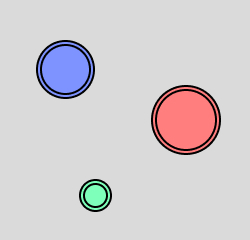

In [ ]:
show_pnm('input_1.pnm')

width: 1600 - height: 1000


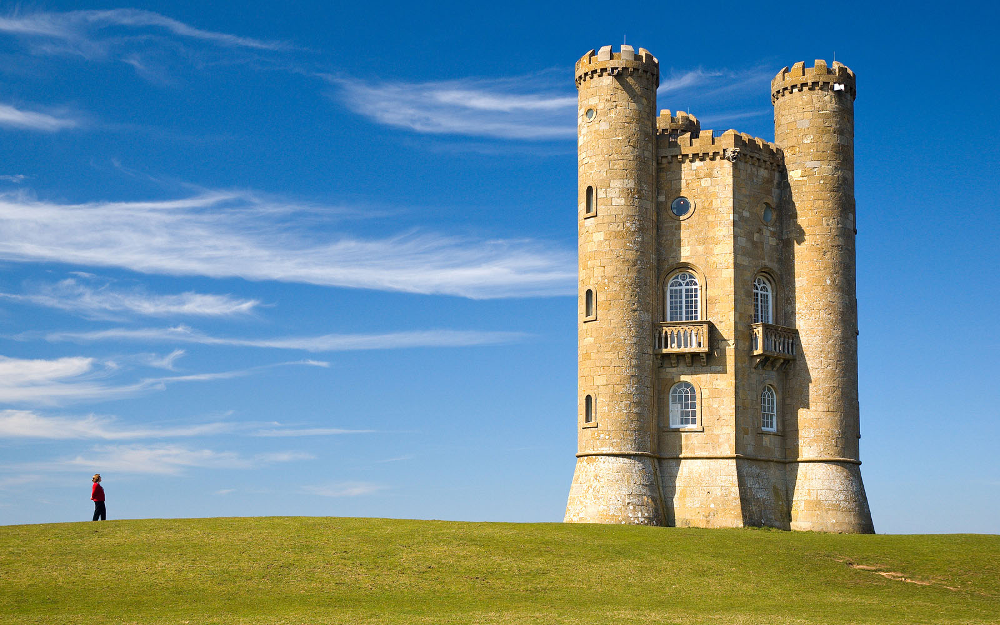

In [ ]:
show_pnm('input_2.pnm')

#### Run Sequential Program

##### Compile Code

In [ ]:
from numba import cuda
major, minor = cuda.get_current_device().compute_capability
print(f'GPU compute capability: {major}.{minor}')

GPU compute capability: 7.5


In [ ]:
!nvcc -arch=sm_{major}{minor} SeamCarving_1.cu -o Ver1

SeamCarving_1.cu(369): warning: variable "blockSize" was set but never used



##### Remove 100 seams

###### Run sequential Program

In [ ]:
!./Ver1 input_1.pnm output_1.pnm 100

**********GPU info**********
Name: Tesla T4
Compute capability: 7.5
Num SMs: 40
Max num threads per SM: 1024
Max num warps per SM: 32
GMEM: 15843721216 byte
SMEM per SM: 65536 byte
SMEM per block: 49152 byte
****************************

Image size (width x height): 250 x 240
DONE ! 
Time: 1161.100 ms
HMM 


In [ ]:
!./Ver1 input_2.pnm output_2.pnm 100

**********GPU info**********
Name: Tesla T4
Compute capability: 7.5
Num SMs: 40
Max num threads per SM: 1024
Max num warps per SM: 32
GMEM: 15843721216 byte
SMEM per SM: 65536 byte
SMEM per block: 49152 byte
****************************

Image size (width x height): 1600 x 1000
DONE ! 
Time: 39068.645 ms
HMM 


###### Result

width: 150 - height: 240


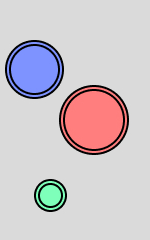

In [ ]:
show_pnm('output_1_host.pnm')

width: 1500 - height: 1000


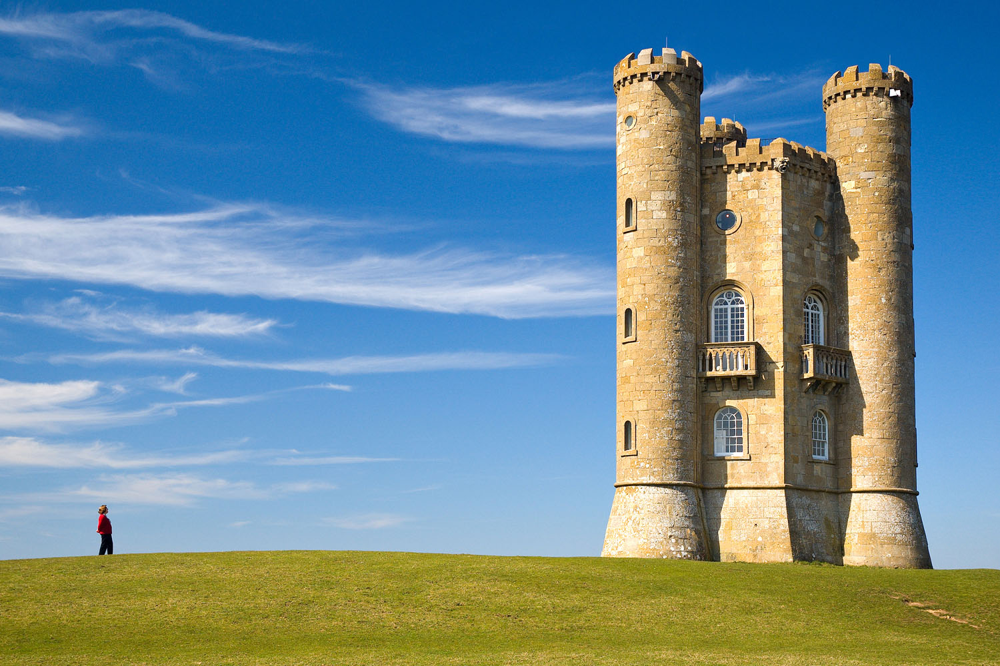

In [ ]:
show_pnm('output_2_host.pnm')


The results show that important details are not lost or corrupted when running with large image sizes. The width of both images is reduced by 100 pixels.<br/>

##### Remove 500 seams in second picture

###### Run sequential Program

In [ ]:
!./Ver1 input_2.pnm output_2_500.pnm 500

**********GPU info**********
Name: Tesla T4
Compute capability: 7.5
Num SMs: 40
Max num threads per SM: 1024
Max num warps per SM: 32
GMEM: 15843721216 byte
SMEM per SM: 65536 byte
SMEM per block: 49152 byte
****************************

Image size (width x height): 1600 x 1000
DONE ! 
Time: 169359.531 ms
HMM 


###### Result

width: 1100 - height: 1000


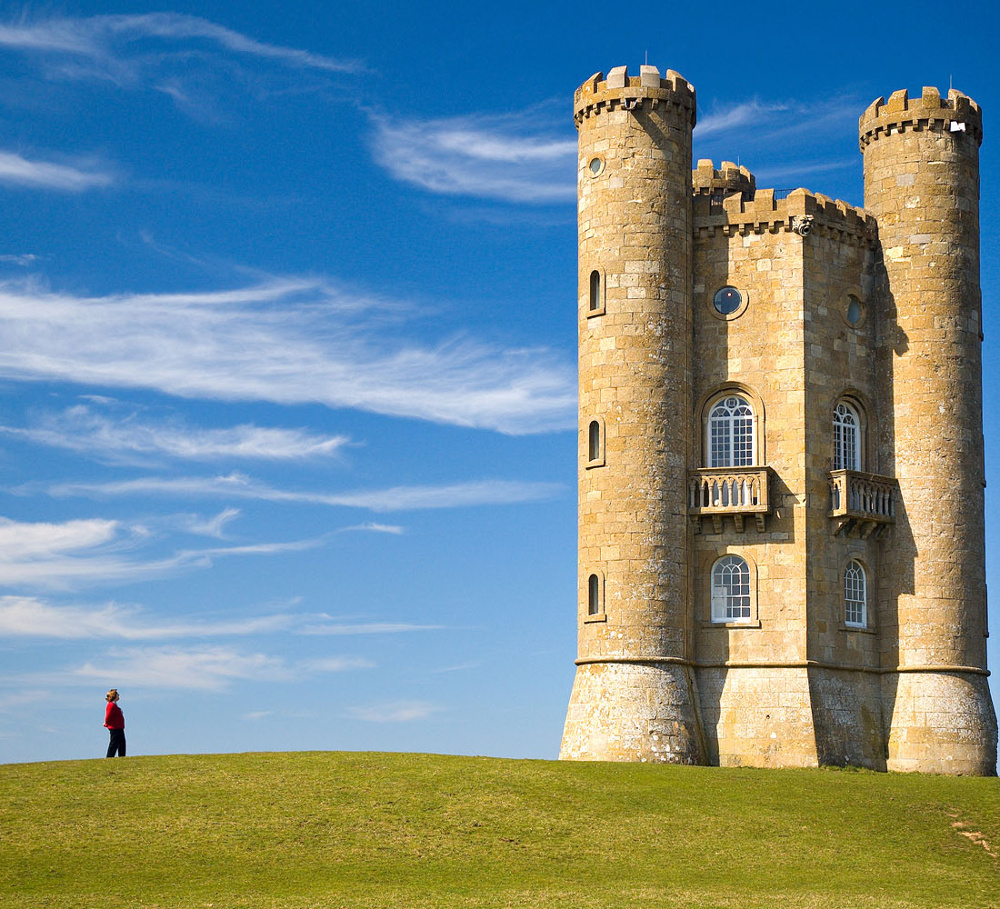

In [ ]:
show_pnm('output_2_500_host.pnm')

Perfect! The image still retains important objects.
But the time seems a bit long.

## 3. Parallel Implement

### Analyze

Analyze the steps that need to be parallelized:

- Step 1: Convert from color image to grayscale image (already implemented in HW1). Each thread will perform the conversion from color pixel to gray pixel in parallel because each pixel is independent of the other.
-
Step 2: Perform convolution operation with each pixel (already implemented in HW1). Each thread will need the surrounding pixels to perform the convolution operation, but these pixels do not need to be calculated, just need the data of the surrounding pixels
-
Step 3: Calculate the importance matrix from bottom to top: perform sequentially for each row and in parallel with the elements in the same row. Because the result of the previous row is the input for the calculation of the next row, we have to calculate from bottom to top, the elements in the same row do not depend on each other’s calculation results so we can perform in paralle
- .
Step 4: Remove a seam (create a new image without the elements in this seam): each thread will be responsible for processing one element and this is performed independently of each other.


### Design

Design parallelization:

- Read input image files.

- Perform conversion from color images to grayscale images.

Repeat these steps until the desired size is achieved:

- Perform convolution on grayscale images.

- Calculate the importance matrix from the bottom up.

- Find seams from pixels with the lowest importance (with input color image array and gray .
e resulting image file.

### Run Parallel Program

#### Compile Code

In [ ]:
!nvcc -arch=sm_{major}{minor} SeamCarving_4.cu -o Ver4

#### Remove 100 seams in both pictures

##### Run program

In [ ]:
!./Ver4 input_1.pnm 100


Image size (width x height): 250 x 240
DONE 
Time: 360.428 ms


In [ ]:
!./Ver4 input_2.pnm 100 # block Size mặc định là 32 32


Image size (width x height): 1600 x 1000
DONE 
Time: 2707.371 ms


##### Show result

width: 1500 - height: 1000


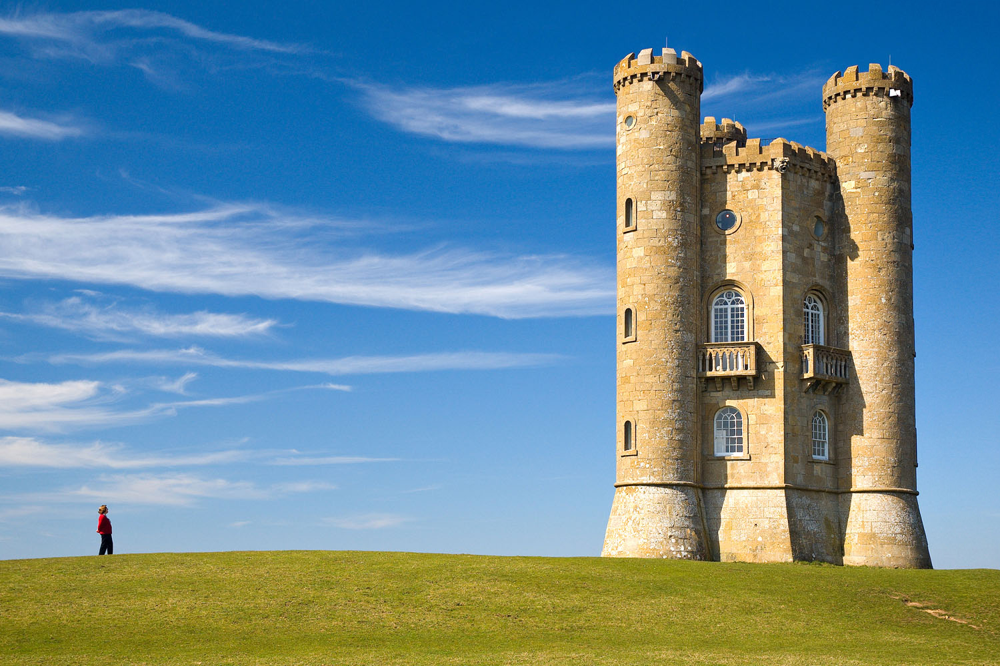

In [ ]:
show_pnm('seams_removed.pnm')

width: 1500 - height: 1000


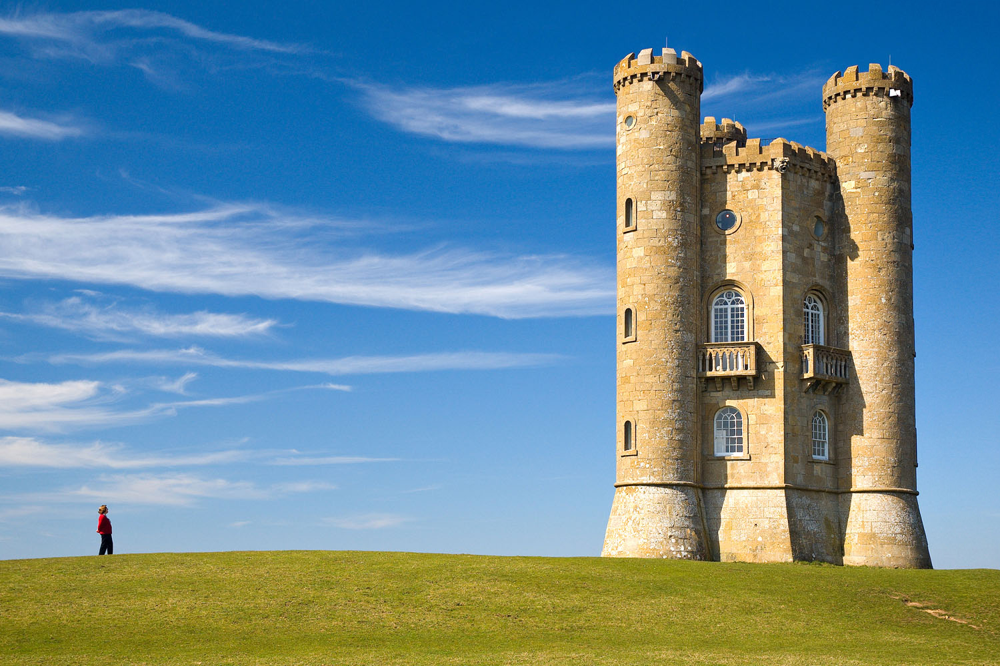

In [ ]:
show_pnm('seams_removed.pnm')

The result is that the important objects remain the same but in a much faster time. Try a different Seam number and blockSize to make sure there is no error.

#### Remove 500 seams in second picture

##### Run program

In [ ]:
!./Ver4 input_2.pnm  500


Image size (width x height): 1600 x 1000
DONE 
Time: 11766.086 ms


width: 1100 - height: 1000


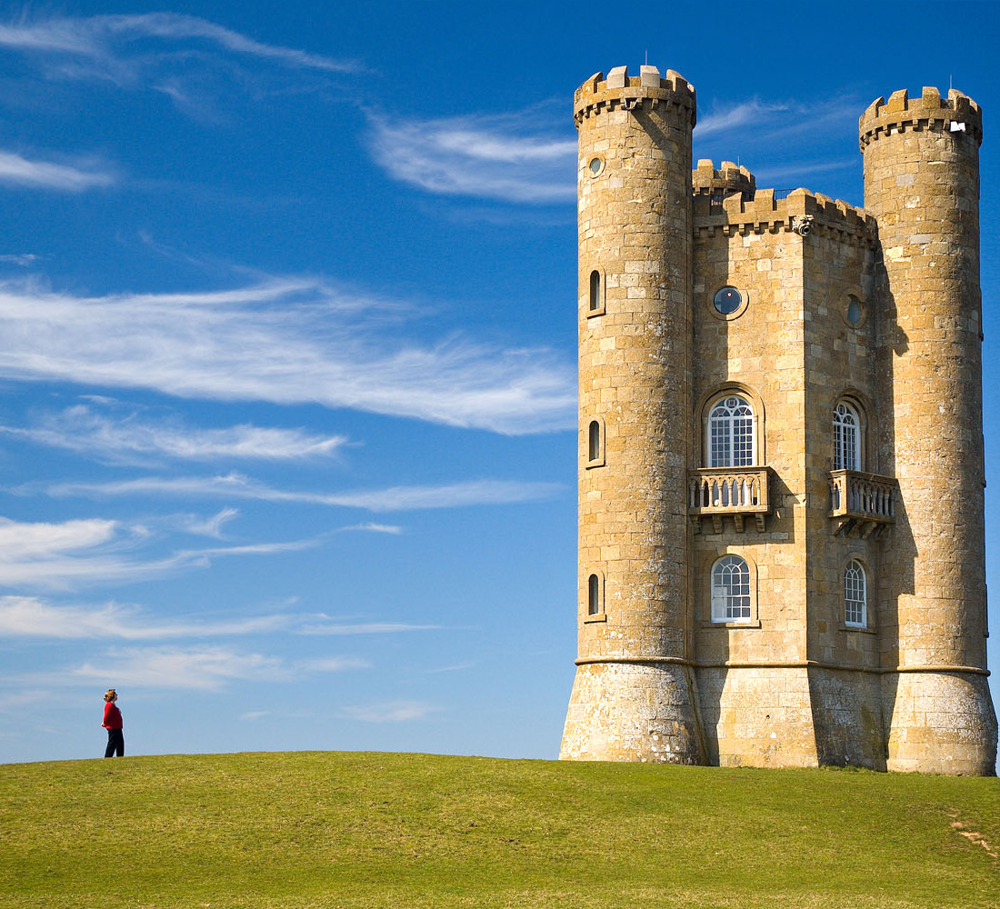

In [ ]:
show_pnm('seams_removed.pnm')

#### Remove 1000 seams in figure 2, block size 16 x 1616

In [ ]:
!./Ver4 input_2.pnm  1000 16 16


Image size (width x height): 1600 x 1000
DONE 
Time: 21077.984 ms


width: 600 - height: 1000


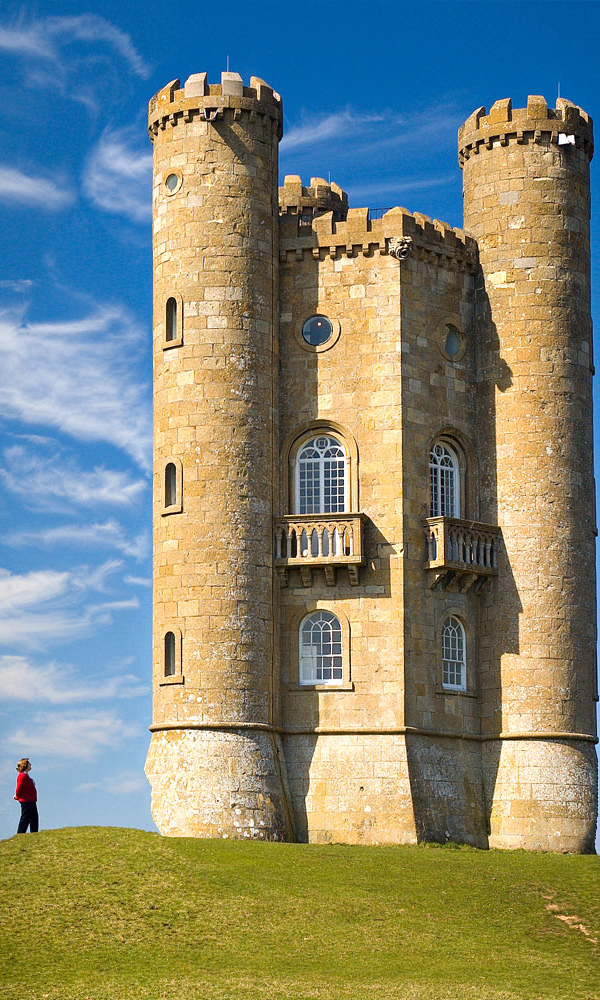

In [ ]:
show_pnm('seams_removed.pnm')

Seem good!

## 4.Parallel installation + improvements

#### Improvement 1
We will use smem for the convolution function. The remaining steps are similar to above

#### Compile Code

In [ ]:
!nvcc -arch=sm_{major}{minor} SeamCarving_6.cu -o Ver6

#### Run Program

In [ ]:
!./Ver6 input_1.pnm 100


Image size (width x height): 250 x 240
DONE 
Time: 361.642 ms


width: 150 - height: 240


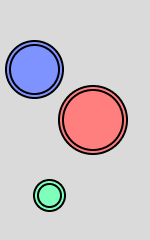

In [ ]:
show_pnm('seams_removed.pnm')

In [ ]:
!./Ver6 input_2.pnm 100 # block Size mặc định là 32 32


Image size (width x height): 1600 x 1000
DONE 
Time: 2730.620 ms


width: 1500 - height: 1000


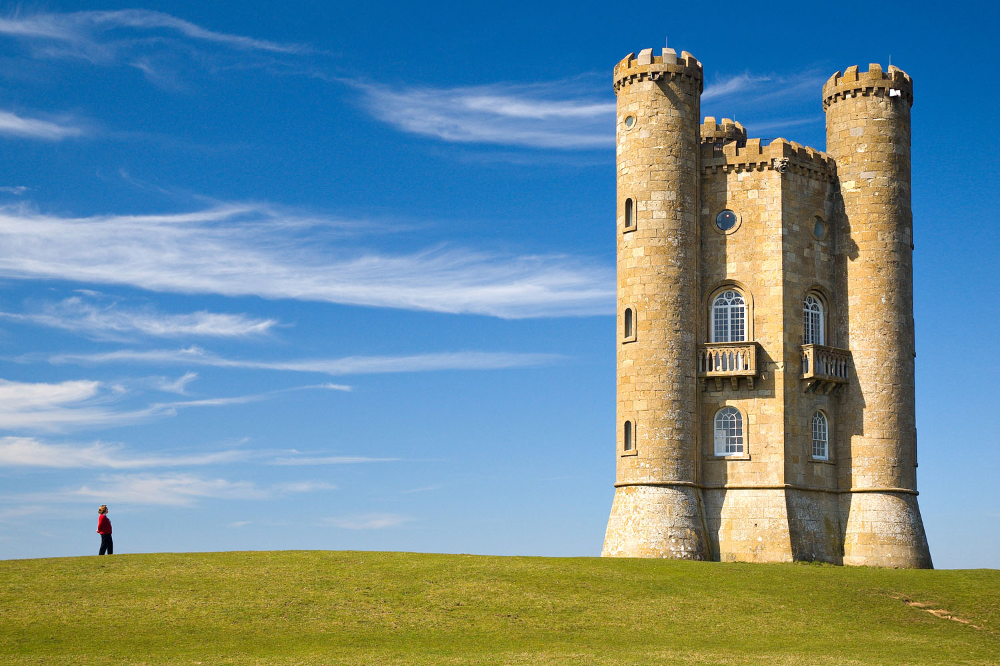

In [ ]:
show_pnm('seams_removed.pnm')

In [ ]:
!./Ver4 input_2.pnm  500


Image size (width x height): 1600 x 1000
DONE 
Time: 11974.383 ms


width: 1100 - height: 1000


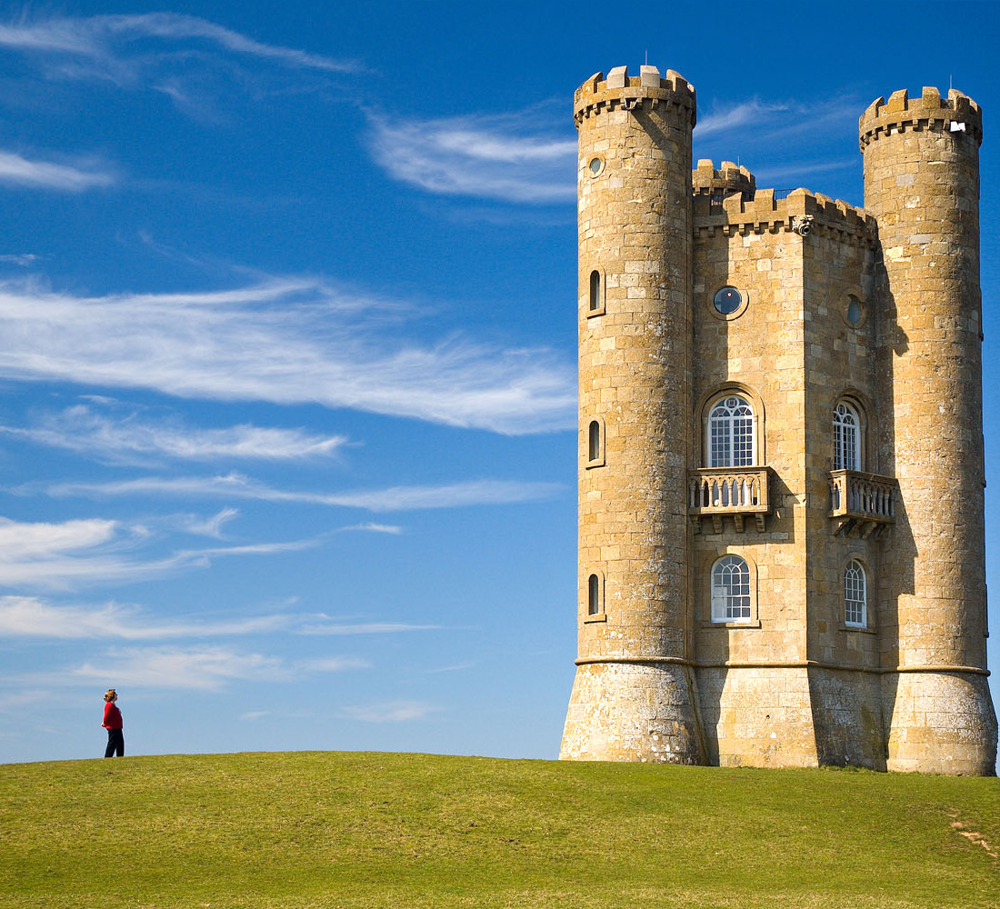

In [ ]:
show_pnm('seams_removed.pnm')

### Improvement 2

#### Ideal

Use a greedy importance function based on prefix sum and traceback.
The remaining steps are as above.

Suppose we have a matrix after calculating convolution as follows.<br/>


|  a  |  b  |  c  |  d  |  e  |
| --- | --- | --- | --- | --- |
| 1 | 9 | 9 | 9 | 9 |
| 9 | 1 | 9 | 9 | 9 |
| 9 | 9 | 1 | 9 | 9 |
| 9 | 9 | 9 | 1 | 9 |


Add the min value of line 0 to line 1,and  line 2 to line 3. Similar to prefi xsum and update the traceback matrix.<br/>
Importance matrix


|  a  |  b  |  c  |  d  |  e  |
| --- | --- | --- | --- | --- |
| 2 | 10 | 10 | 18 | 18 |
| x | x | x | x | x |
| 18 | 18 | 2 | 10 | 10 |
| 9  | 9  | 9 | 1 | 9 |

Traceback matrix

|  a  |  b  |  c  |  d  |  e  |
| --- | --- | --- | --- | --- |
| 1 | 1 | 1 | 3 | 4 |
| x | x | x | x | x |
| 0  | 1  | 3 | 3 | 3 |
| 0  | 0  | 0 | 0 | 0 |

Next we will add lines 0 - 2 based on the traceback matrix. For example, cell (0,0) we see that it is added by cell (1,1). We will find the value of line 2 such that + with cell (1,1) is the lowest. Then we will take that value and add it to cell (0,0).<br/>
Importance matrix

|  a  |  b  |  c  |  d  |  e  |
| --- | --- | --- | --- | --- |
| 4 | 12 | 12 | 20 | 28 |
| x | x | x | x | x |
| 0  | 1  | 3 | 3 | 3 |
| 0  | 0  | 0 | 0 | 0 |

Traceback matrix

|  a  |  b  |  c  |  d  |  e  |
| --- | --- | --- | --- | --- |
| 1 | 1 | 1 | 3 | 4 |
| 2 | 2 | 2 | 2 | 4 |
| 0  | 1  | 3 | 3 | 3 |
| 0  | 0  | 0 | 0 | 0 |

Smallest value 4 -> trace back to 1 1 1 1

#### Compile Code

In [ ]:
!nvcc -arch=sm_{major}{minor} SeamCarving_5.cu -o Ver5

SeamCarving_5.cu(315): warning: variable "size" was declared but never referenced



#### Run Program

In [ ]:
!./Ver5 input_1.pnm output_5_1.pnm 100

**********GPU info**********
Name: Tesla T4
Compute capability: 7.5
Num SMs: 40
Max num threads per SM: 1024
Max num warps per SM: 32
GMEM: 15843721216 byte
SMEM per SM: 65536 byte
SMEM per block: 49152 byte
****************************

Image size (width x height): 250 x 240
CUDA START 
Kernel time: 38.403168 ms
DONE ! 
HMM 


In [ ]:
!./Ver5 input_2.pnm output_5_2.pnm 100

**********GPU info**********
Name: Tesla T4
Compute capability: 7.5
Num SMs: 40
Max num threads per SM: 1024
Max num warps per SM: 32
GMEM: 15843721216 byte
SMEM per SM: 65536 byte
SMEM per block: 49152 byte
****************************

Image size (width x height): 1600 x 1000
CUDA START 
Kernel time: 971.446655 ms
DONE ! 
HMM 


In [ ]:
!./Ver5 input_2.pnm output_5_3.pnm 500

#### Show Result

width: 150 - height: 240


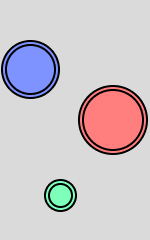

In [ ]:
show_pnm('output_5_1_device.pnm')

width: 1500 - height: 1000


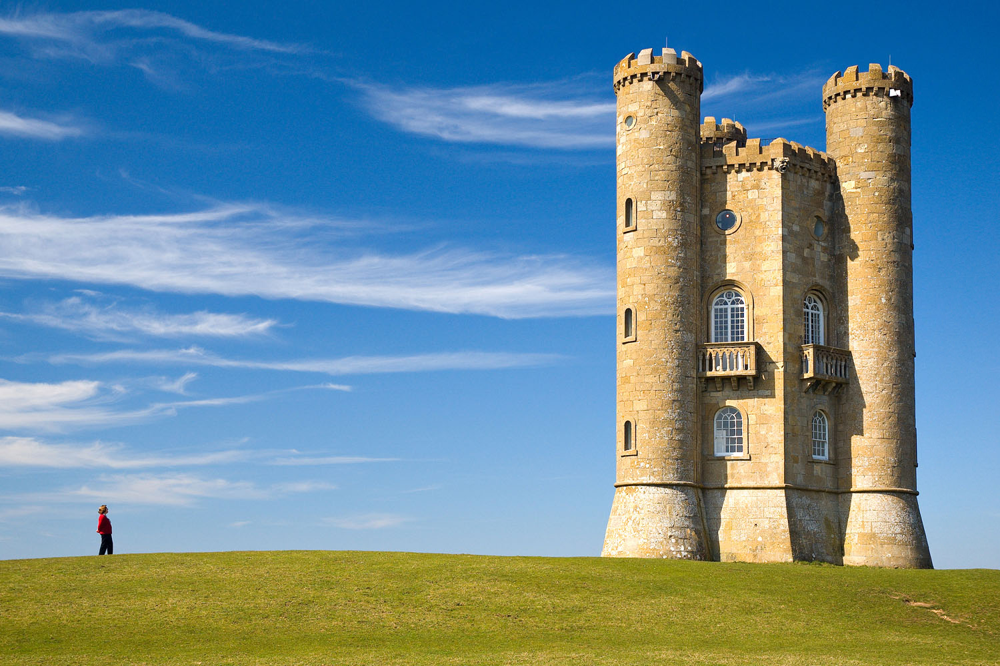

In [ ]:
show_pnm('output_5_2_device.pnm')

width: 1100 - height: 1000


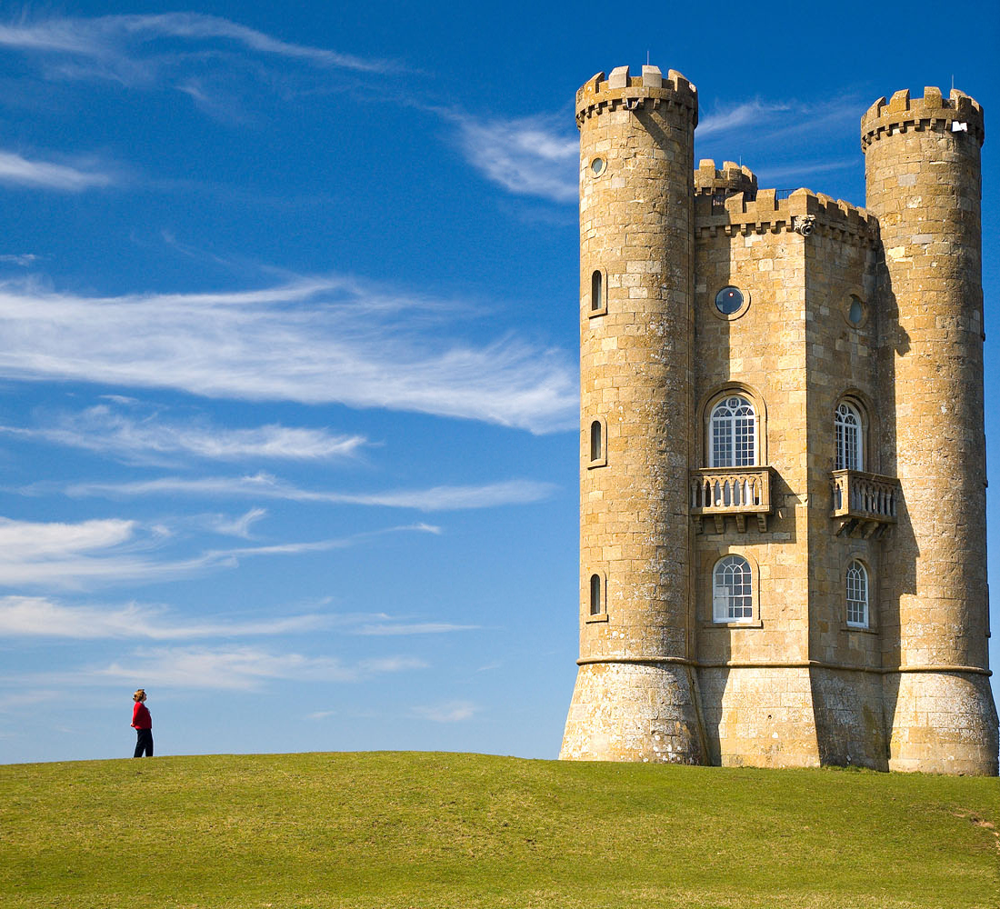

In [ ]:
show_pnm('output_5_3_device.pnm')

Compare version times (time unit: ms)

|  Phiên bản   | Hình 1 - 100 seam |  Hình 2 - 100 seam |  Hình 2 - 500 seam |
| --- | --- | --- | --- |
| Tuần tự     | 1161.100  | 39068.645  | 169359.531 |
| Song song   |  360.428  | 2707.371 | 11766.086 |
| Cải tiến 1  | 361.642 | 2730.620 | 11974.383 |
| Cải tiến 2  | 38.403 | 971.44 | 4170.495 |

## 5.Looking back at the project making process


Dangt: I tried to do the important dynamic planning step in parallel but it didn't work. I also hope to have more time to improve.

Thang: Due to having to prepare other subjects for the final exam, the time to do the project is not as much as expected. I learned how to work in groups and write a complete cuda program.

If the team has twe they will make the program run even faster.


## 6. Tài liệu tham khảo

Slide bài giảng của thầy Phạm Trọng Nghĩa.

[Bài giảng về seam carving - part 1](https://www.youtube.com/watch?v=rpB6zQNsbQU)

[Bài giảng về seam carving - part 2](https://www.youtube.com/watch?v=ALcohd1q3dk)